## Download the data

Notes: 
Download url: 'https://docs.google.com/uc?export=download&id=1ePP7ioTxuv6T0t7S6mT4tGE53XCyohjZ'

File url: https://drive.google.com/file/d/1ePP7ioTxuv6T0t7S6mT4tGE53XCyohjZ/view?usp=sharing

In [ ]:
!git clone https://github.com/wwang/ML_CV_Teaching.git

Cloning into 'ML_CV_Teaching'...
remote: Enumerating objects: 150, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 150 (delta 12), reused 36 (delta 8), pack-reused 110
Receiving objects: 100% (150/150), 65.92 MiB | 38.27 MiB/s, done.
Resolving deltas: 100% (57/57), done.


## Load libraries

In [ ]:
import ML_CV_Teaching.lane_detection.lane_pkg as lp

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2
import numpy as np
%matplotlib inline

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)2318336/45929032 bytes (5.0%)5513216/45929032 bytes (12.0%)8773632/45929032 bytes (19.1%)12099584/45929032 bytes (26.3%)15360000/45929032 bytes (33.4%)18669568/45929032 bytes (40.6%)22126592/45929032 bytes (48.2%)25321472/45929032 bytes (55.1%)28737536/45929032 bytes (62.6%)32055296/45929032 bytes (69.8%)34758656/45929032 bytes (75.7%)37388288/45929032 bytes (81.4%)

## Load Image

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


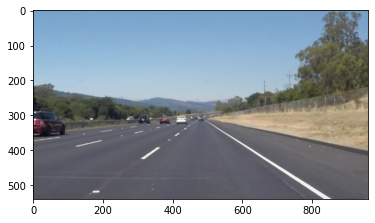

In [ ]:
#reading in an image
image = mpimg.imread('ML_CV_Teaching/lane_detection/test_images/solidWhiteRight.jpg')

#printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)

## Image Processing Example

### Set to grayscale

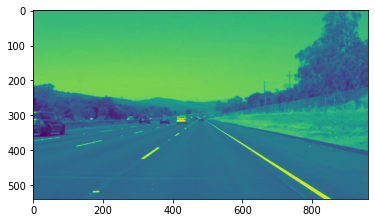

In [ ]:
imshape = image.shape

#Convert to grayscale
grayscaleImage = lp.grayscale(image)
plt.imshow(grayscaleImage)

### Gussian blur

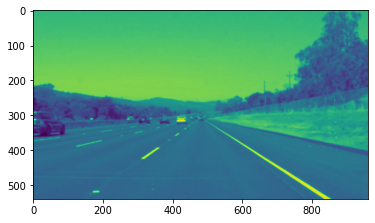

In [ ]:
#Apply gaussian blur
gaussianImage = lp.gaussian_blur(grayscaleImage, 5)
plt.imshow(gaussianImage)

### Show edges in the Image

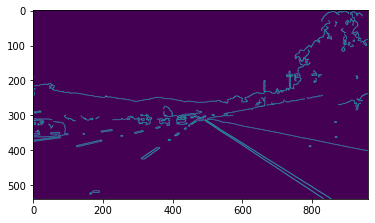

In [ ]:
#Find the edges in the image
cannyImage = lp.canny(gaussianImage, 50, 150)
plt.imshow(cannyImage)

### Remove unused edges

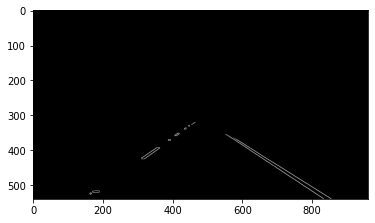

In [ ]:
#Limit to a region of interest, in this case the lanes
roiMask = lp.gen_roi_mask(imshape) #np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
edgeMask = lp.region_of_interest(cannyImage, roiMask)
#Only the required edges are displayed and rest is set to black
edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2BGR)
plt.imshow(edgeMaskImage)

### Highlight detected edges

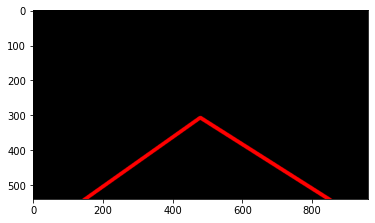

In [ ]:
#Hough lines transform to detect straight lines and then highlight the detected line
#rho = 2
#theta = np.pi/180
#threshold = 15
#min_line_len = 40
#max_line_gap = 20
linesImage = lp.hough_lines(edgeMask)  
plt.imshow(linesImage)

### Add the Highlights back to image

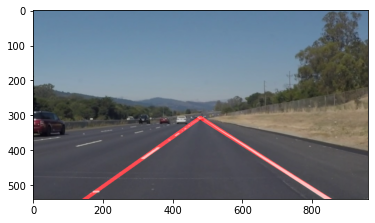

In [ ]:
marked_img = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
plt.imshow(marked_img)

## Define a function to do all the work


In [ ]:
def process_image(image):
    imshape = image.shape
    #Convert to grayscale
    grayscaleImage = lp.grayscale(image)

    #Apply gaussian blur
    gaussianImage = lp.gaussian_blur(grayscaleImage, 5)

    #Fine the edges in the image
    cannyImage = lp.canny(gaussianImage, 50, 150)

    #Limit to a region of interest, in this case the lanes
    roiMask = np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
    edgeMask = lp.region_of_interest(cannyImage, roiMask)
    #Only the required edges are displayed and rest is set to black
    edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2BGR)
    
    #Hough lines
    rho = 2
    theta = np.pi/180
    threshold = 15
    min_line_len = 40
    max_line_gap = 20
    linesImage = lp.hough_lines(edgeMask, rho, theta, threshold, min_line_len, max_line_gap)    
    
    result = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
    return result


### Test this function

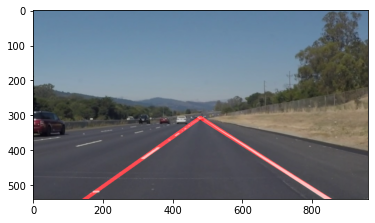

In [ ]:
marked_img = lp.process_image(image)
plt.imshow(marked_img)

## Process videos

We will extract each frame of a video to detect the lane in the video

### Add a few more libraries

In [ ]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### Load first video

In [ ]:
clip1_path = 'ML_CV_Teaching/lane_detection/test_videos/solidWhiteRight.mp4'
clip1 = VideoFileClip(clip1_path)
lp.playvideo(clip1_path)
#clip1.ipython_display(clip1)

### Process the first video

In [ ]:
# set output file name
clip1_output = 'clip1_out.mp4'

# use "process_image" function to process very frame in clip1
clip1_marked = clip1.fl_image(lp.process_image)

# save the marked clip1
%time clip1_marked.write_videofile(clip1_output, audio=False)

# show marked clip1
#clip1.ipython_display(clip1_marked)
lp.playvideo(clip1_output)

[MoviePy] >>>> Building video clip1_out.mp4
[MoviePy] Writing video clip1_out.mp4


100%|█████████▉| 221/222 [00:10<00:00, 21.18it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: clip1_out.mp4 

CPU times: user 3.82 s, sys: 341 ms, total: 4.16 s
Wall time: 12.1 s


### Load the second Video

In [ ]:
clip2_path = 'ML_CV_Teaching/lane_detection/test_videos/solidYellowLeft.mp4'
clip2 = VideoFileClip(clip2_path)
lp.playvideo(clip2_path)


### Process the second video

In [ ]:
# set output file name
clip2_output = 'clip2_out.mp4'

# use "process_image" function to process very frame in clip1
clip2_marked = clip2.fl_image(lp.process_image)

# save the marked clip1
%time clip2_marked.write_videofile(clip2_output, audio=False)

# show marked clip1
#clip1.ipython_display(clip1_marked)
lp.playvideo(clip2_output)

[MoviePy] >>>> Building video clip2_out.mp4
[MoviePy] Writing video clip2_out.mp4


100%|█████████▉| 681/682 [00:36<00:00, 18.79it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: clip2_out.mp4 

CPU times: user 12.2 s, sys: 1.35 s, total: 13.6 s
Wall time: 37.9 s


## Update Git Repo

In [ ]:
!cd ExploreSTEM/; git pull origin master

remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 4 (delta 1), reused 4 (delta 1), pack-reused 0
Unpacking objects: 100% (4/4), done.
From https://github.com/wwang/ExploreSTEM
 * branch            master     -> FETCH_HEAD
   40d6113..03432b4  master     -> origin/master
Updating 40d6113..03432b4
Fast-forward
 lane_detection/lane_pkg.py | 2 +-
 1 file changed, 1 insertion(+), 1 deletion(-)
